In [1]:
import geopandas as gpd
import matplotlib.pyplot as plt
import numpy as np
from collections import Counter

In [2]:
df_tree = gpd.read_file('les-arbres.geojson')

In [3]:
# (df_tree.libellefrancais,
len(set(df_tree.libellefrancais))

230

In [140]:
Counter(df_tree.libellefrancais.values).most_common(11)

[('Platane', 42754),
 ('Marronnier', 24817),
 ('Tilleul', 22706),
 ('Erable', 20162),
 ('Sophora', 10999),
 ('Chêne', 5419),
 ('Pin', 5040),
 ('Frêne', 4911),
 ('Micocoulier', 4868),
 ('Cerisier à fleurs', 4374),
 ('Poirier à fleurs', 3808)]

In [143]:
tree_translations = {
    'Platane': {
        'english': 'Plane tree',
        'russian': 'Платан'
    },
    'Marronnier': {
        'english': 'Horse chestnut',
        'russian': 'Конский каштан'
    },
    'Tilleul': {
        'english': 'Linden',
        'russian': 'Липа'
    },
    'Erable': {
        'english': 'Maple',
        'russian': 'Клён'
    },
    'Sophora': {
        'english': 'Pagoda tree',
        'russian': 'Софора'
    },
    'Chêne': {
        'english': 'Oak',
        'russian': 'Дуб'
    },
    'Pin': {
        'english': 'Pine',
        'russian': 'Сосна'
    },
    'Frêne': {
        'english': 'Ash',
        'russian': 'Ясень'
    },
    'Micocoulier': {
        'english': 'Hackberry',
        'russian': 'Каркас'
    },
    'Cerisier à fleurs': {
        'english': 'Flowering cherry',
        'russian': 'Декоративная вишня'
    },
    'Poirier à fleurs': {
        'english': 'Flowering pear',
        'russian': 'Декоративная груша'
    },
    # 'Charme': {
    #     'english': 'Hornbeam',
    #     'russian': 'Граб'
    # }
}

# Usage examples:
print(tree_translations['Platane']['english'])  # Plane tree
print(tree_translations['Platane']['russian'])  # Платан

# Or access both at once:
tree = 'Marronnier'
print(f"{tree}: {tree_translations[tree]['english']} / {tree_translations[tree]['russian']}")
# Marronnier: Horse chestnut / Конский каштан

Plane tree
Платан
Marronnier: Horse chestnut / Конский каштан


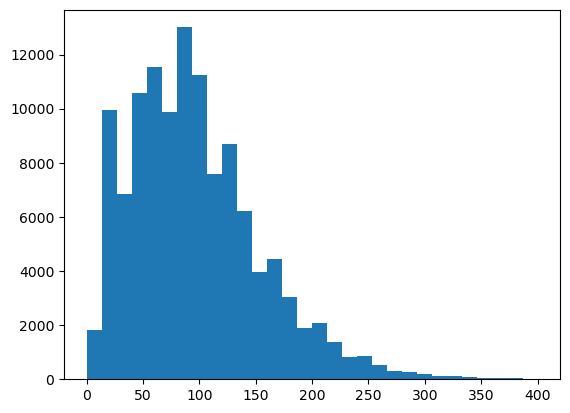

In [156]:
plt.figure()
plt.hist(df_tree_inside.circonferenceencm.values, bins=30, range=(0, 400))
plt.show()

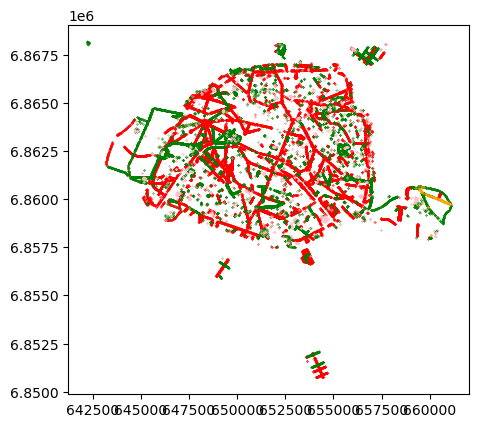

In [6]:
plt.figure()
plt.scatter(df_tree.loc[df_tree.libellefrancais=='Platane'].geometry.x, df_tree.loc[df_tree.libellefrancais=='Platane'].geometry.y, s=.05, color='red')
plt.scatter(df_tree.loc[df_tree.libellefrancais=='Marronnier'].geometry.x, df_tree.loc[df_tree.libellefrancais=='Marronnier'].geometry.y, s=.05, color='green')
plt.scatter(df_tree.loc[df_tree.libellefrancais=='Châtaignier'].geometry.x, df_tree.loc[df_tree.libellefrancais=='Châtaignier'].geometry.y, s=.1, color='orange')
plt.scatter(df_tree.loc[df_tree.libellefrancais=='Magnolia'].geometry.x, df_tree.loc[df_tree.libellefrancais=='Magnolia'].geometry.y, s=.1, color='pink')
plt.gca().set_aspect('equal', adjustable='box')
plt.show()

In [ ]:
# make it in plotly or streamlit to publish?

In [18]:
myshpfile = gpd.read_file('../parisExp/idf_gis_osm_roads_free_1.geojson', driver='GeoJSON')

/Users/mouse13/anaconda3/envs/ocenv/lib/python3.11/site-packages/pyogrio/raw.py:198: RuntimeWarning:

driver GeoJSON does not support open option DRIVER



In [21]:
for name in myshpfile.name:
    if isinstance(name, str):
        if name.startswith('Boulevard Péri'):
            print(name)

Boulevard Périphérique Intérieur
Boulevard Périphérique Extérieur
Boulevard Périphérique Intérieur
Boulevard Périphérique Intérieur
Boulevard Périphérique Extérieur
Boulevard Périphérique Extérieur
Boulevard Périphérique Intérieur
Boulevard Périphérique Extérieur
Boulevard Périphérique Extérieur
Boulevard Périphérique Intérieur
Boulevard Périphérique Extérieur
Boulevard Périphérique Intérieur
Boulevard Périphérique Intérieur
Boulevard Périphérique Extérieur
Boulevard Périphérique Intérieur
Boulevard Périphérique Intérieur
Boulevard Périphérique Extérieur
Boulevard Périphérique Extérieur
Boulevard Périphérique Extérieur
Boulevard Périphérique Intérieur
Boulevard Périphérique Intérieur
Boulevard Périphérique Intérieur
Boulevard Périphérique Intérieur
Boulevard Périphérique Extérieur
Boulevard Périphérique Extérieur
Boulevard Périphérique Intérieur
Boulevard Périphérique Extérieur
Boulevard Périphérique Intérieur
Boulevard Périphérique Extérieur
Boulevard Périphérique Intérieur
Boulevard 

In [28]:
myshpfile = myshpfile.dropna(subset='name')

In [29]:
peri_shp = myshpfile.loc[myshpfile.name.str.startswith("Boulevard Périphérique")]

<Axes: >

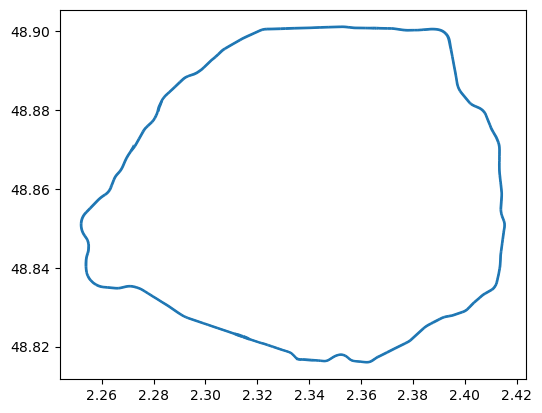

In [30]:
peri_shp.plot()

In [145]:
from shapely.ops import unary_union, linemerge
from shapely.geometry import LineString, MultiLineString

road_lines = peri_shp.geometry.tolist()
merged_lines = linemerge(road_lines)
road_polygon = gpd.GeoDataFrame(geometry=[merged_lines.convex_hull], crs=myshpfile.crs)
df_tree_inside = df_tree.to_crs('EPSG:4326').clip(road_polygon)
df_tree_inside = df_tree_inside.loc[df_tree_inside.libellefrancais.isin(tree_translations.keys())]
df_tree_inside['color'] = df_tree_inside['libellefrancais'].map(
    lambda x: tree_colors.get(x, '#808080')  # Default gray for unknown types
)

In [146]:
# Convert CRS once
df_wgs84 = df_tree_inside.to_crs('EPSG:4326')
arrondissements_wgs84 = arrondissements.to_crs('EPSG:4326')
arrondissements_wgs84 = arrondissements_wgs84.clip(road_polygon)

In [161]:
import plotly.graph_objects as go

tree_colors = {
    'Platane': '#6f9546',  # Pimento
    'Marronnier': '#954535',  # Endo
    'Tilleul': '#e1e679',  # Sinsemilla
    'Erable': '#db7207',  # Dragon's Blood
    'Sophora': '#56cadd',  # Jubilant Jade
    'Chêne': '#9b682d',  # King Neptune
    'Pin': '#39a09b',  # Submerged
    'Frêne': '#9d9c43',  # Highlands
    'Micocoulier': '#7a88c0',  # Natural Orchestra
    'Cerisier à fleurs': '#ff92c4',  # Magenta Memoir
    'Poirier à fleurs': '#e9e0c3',  # Enchanted Lavender
    # 'Charme': '#8ad080'  # Mossy Glossy
}

# Map colors to dataframe
df_tree_inside['color'] = df_tree_inside['libellefrancais'].map(
    lambda x: tree_colors.get(x, '#7c7328')  # Bay Leaf as default for unknown types
)

# Update marker size mapping
def map_size_custom(circumference):
    """Custom bins with smaller marker sizes"""
    if circumference < 100:
        return 3
    elif circumference < 200:
        return 5
    # elif circumference < 150:
    #     return 7
    # elif circumference < 250:
    #     return 10
    else:
        return 7

df_tree_inside['marker_size'] = df_tree_inside['circonferenceencm'].apply(map_size_custom)

center_lat = df_wgs84.geometry.y.mean()
aspect_ratio = 1 / np.cos(np.radians(center_lat))

In [162]:
df_tree_inside['marker_size']

147878    7
167972    3
190618    5
141084    3
117503    3
         ..
130929    3
17305     3
82808     5
46316     5
21493     5
Name: marker_size, Length: 117668, dtype: int64

In [163]:
fig = go.Figure()

# Add tree markers (main data)
fig.add_trace(
    go.Scattergl(
        x=df_wgs84.geometry.x,
        y=df_wgs84.geometry.y,
        mode='markers',
        text=df_tree_inside['adresse'],
        customdata=df_tree_inside[['libellefrancais', 'circonferenceencm']],
        hovertemplate=(
            '<b>%{customdata[0]}</b><br>' +
            'Address: %{text}<br>' +
            'Circumference: %{customdata[1]} cm<br>' +
            '<extra></extra>'
        ),
        marker=dict(
            size=df_tree_inside['marker_size'],
            color=df_tree_inside['color'],
            opacity=0.7,
            line=dict(width=0.5, color='white')
        ),
        showlegend=False
    )
)


for idx, row in arrondissements_wgs84.iterrows():
    if row.geometry.geom_type == 'Polygon':
        x, y = row.geometry.exterior.xy
        fig.add_trace(go.Scattergl(
            x=list(x), y=list(y),
            mode='lines',
            line=dict(color='#333333', width=1.5),
            showlegend=False,
            hoverinfo='skip',
            name='Arrondissement'
        ))
    elif row.geometry.geom_type == 'MultiPolygon':
        for poly in row.geometry.geoms:
            x, y = poly.exterior.xy
            fig.add_trace(go.Scattergl(
                x=list(x), y=list(y),
                mode='lines',
                line=dict(color='#333333', width=1.5),
                showlegend=False,
                hoverinfo='skip'
            ))

# Calculate ranges for positioning
lon_range = df_wgs84.geometry.x.max() - df_wgs84.geometry.x.min()
lat_range = df_wgs84.geometry.y.max() - df_wgs84.geometry.y.min()

# Tree types legend (top center, horizontal)
tree_types_list = list(tree_colors.items())
num_trees = len(tree_types_list)
tree_base_x = df_wgs84.geometry.x.min() #+ #lon_range * 0.2 - (num_trees - 1) * lon_range * 0.04
tree_base_y = df_wgs84.geometry.y.max() + lat_range * 0.1

for i, (tree_type, color) in enumerate(tree_types_list):
    fig.add_trace(
        go.Scatter(
            x=[tree_base_x + i * lon_range / (len(tree_types_list) - 1)],
            y=[tree_base_y],
            mode='markers',
            marker=dict(size=14, color=color, line=dict(width=0.5, color='white')),
            hovertemplate=(
                '<b>%{text} </b><br>' +
                tree_translations[tree_type]['english'] + ' <br>' +
                tree_translations[tree_type]['russian'] + ' '
                '<extra></extra>'
            ),
            text=[tree_type],
            showlegend=False
        )
    )
    # Add text label below marker
    fig.add_annotation(
        x=tree_base_x + i * lon_range / (len(tree_types_list) - 1),
        y=tree_base_y - lat_range * 0.03,
        text=tree_translations[tree_type]['english'],
        showarrow=False,
        font=dict(size=11, color='#333333', family='Lato, sans-serif'),
        xanchor='center',
        yanchor='top',
        textangle=-15
    )

# Add "Tree Types" title
fig.add_annotation(
    x=df_wgs84.geometry.x.min() + lon_range * 0.5,
    y=tree_base_y + lat_range * 0.05,
    text='Tree Types',
    showarrow=False,
    font=dict(size=15, color='#000000', family='Lato, sans-serif', weight='bold'),
    xanchor='center',
    textangle=0
)

# Circumference legend (bottom right, horizontal)
size_categories = [
    ('0-100', 3),
    ('100-200', 5),
    ('200+', 7),
    # ('150-250', 10),
    # ('250+', 12)
]

circ_base_x = df_wgs84.geometry.x.min() + lon_range * 0.06
circ_base_y = df_wgs84.geometry.y.min() + lat_range * 0.03

# Add circumference markers as actual plot elements
for i, (label, size) in enumerate(size_categories):
    fig.add_trace(
        go.Scatter(
            x=[circ_base_x + i * lon_range * 0.065],
            y=[circ_base_y],
            mode='markers',
            marker=dict(size=size, color='#7c7328', line=dict(width=0.5, color='white')),
            showlegend=False,
            hoverinfo='skip'
        )
    )
    # Add text label below marker
    fig.add_annotation(
        x=circ_base_x + i * lon_range * 0.065,
        y=circ_base_y - lat_range * 0.018,
        text=label,
        showarrow=False,
        font=dict(size=11, color='#333333', family='Lato, sans-serif'),
        xanchor='center',
        yanchor='top',
    )

# Add "Circumference (cm)" title
fig.add_annotation(
    x=circ_base_x + 1 * lon_range * 0.065,
    y=circ_base_y + lat_range * 0.025,
    text='Circumference (cm)',
    showarrow=False,
    font=dict(size=15, color='#000000', family='Lato, sans-serif', weight='bold'),
    xanchor='center'
)

fig.update_layout(
    width=1200,
    height=800,
    hovermode='closest',
    plot_bgcolor='white',
    xaxis=dict(
        visible=False,
        showgrid=False,
        zeroline=False
    ),
    yaxis=dict(
        visible=False,
        showgrid=False,
        zeroline=False,
        scaleanchor="x",
        scaleratio=aspect_ratio
    ),
    margin=dict(l=2, r=2, t=5, b=2)
)

fig.write_html('trees_test.html')
fig.show()